Experiment with spiral shape galaxy data synthesis

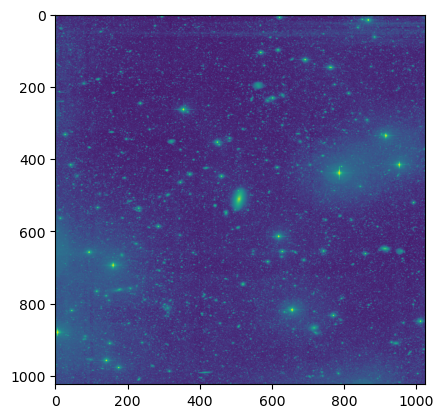

In [18]:
import numpy as np
import matplotlib.pyplot as plt
import glob 
import os
import cv2

import random
from copy import deepcopy

# Load the .npy file
file_name = "../datasets/matlas_images_and_annotations/images/name=IC0598.npy"
data = np.load(file_name)

# Display the data
plt.imshow(data[0,:,:])
plt.show()

In [48]:
file_path = "../datasets/matlas_images_and_annotations/"
annotation_file_path = file_path + "annotations/standard/double/basichalosnocompanions_splittidal/"

structure_name = {}
mask_files_name = {}

structure_name["Elongated tidal structures"] = "Elongated tidal structures"
mask_files_name["Elongated tidal structures"] = glob.glob(annotation_file_path + "*" + structure_name["Elongated tidal structures"] + ".npz")

# get the label file that has tidal structures then link to npy file
structure_files_name = ["=".join(structure_file.split("/")[-1].split('=')[:2])[:-6] + ".npy" for structure_file in mask_files_name["Elongated tidal structures"]]

structure_name["Diffuse halo"] = "Diffuse halo"
mask_files_name["Diffuse halo"] = [annotation_file_path + "=".join(structure_file.split("/")[-1].split('=')[:2] + [structure_name["Diffuse halo"]]) + ".npz" for structure_file in mask_files_name["Elongated tidal structures"]]

structure_name["Galaxy"] = "Galaxy"
mask_files_name["Galaxy"] = [annotation_file_path + "=".join(structure_file.split("/")[-1].split('=')[:2] + [structure_name["Galaxy"]]) + ".npz" for structure_file in mask_files_name["Elongated tidal structures"]]

structure_name["Elongated plus Galaxy"] = "Elongated plus Galaxy"
mask_files_name["Elongated plus Galaxy"] = glob.glob(annotation_file_path + "*" + structure_name["Elongated plus Galaxy"] + ".npz")

In [20]:
from scipy import ndimage

def decode_np_mask(array):
    shape, mask, centre = array['shape'], array['mask'], array['centre']
    mask = np.unpackbits(mask)
    mask = mask[:np.prod(shape)]
    
    return mask.reshape(shape), centre

def getMask(mask_files_name, mask_files_name2=None):
    mask_path = mask_files_name
    mask_path2 = mask_files_name2
    # try:
    if mask_files_name2 == None:
        mask = decode_np_mask(np.load(mask_path, allow_pickle=True))[0]
        mask = mask[np.count_nonzero(mask, axis=(1, 2)) > 0]
        return mask
    
    else:
        mask1 = decode_np_mask(np.load(mask_path, allow_pickle=True))[0]
        mask2 = decode_np_mask(np.load(mask_path2, allow_pickle=True))[0]

        cm1 = [ndimage.center_of_mass(mask) for mask in mask1]
        cm2 = [ndimage.center_of_mass(mask) for mask in mask2]
        
        for i, cm in enumerate(cm2): 
            min_idx = np.argmin(np.linalg.norm(np.array(cm1) - cm, axis=1))

            mask = mask1
            mask[min_idx] = np.logical_or(mask1[min_idx], mask2[i])
        
        mask = mask[np.count_nonzero(mask, axis=(1, 2)) > 0]
        return mask
    
def encode_np_mask(mask, file_name):
    shape = mask.shape
    mask = np.packbits(mask)
    np.savez(file_name, shape=shape, mask=mask, centre=None)

def inverseQuadratic(x, eps=0.2):
    return 1.0/(1+(eps*x)**2)


def augmentElongMask(masks, galaxy_cm, mesh_x, mesh_y, alpha=10):
    mesh_x = mesh_x.astype("float64")
    mesh_y = mesh_y.astype("float64")

    binary_mask = masks.astype(np.uint8)
    contours, hierarchy = cv2.findContours(binary_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)
    
    # unit_vec = np.random.rand(2)-0.5
    unit_vec = np.array([1,0])
    unit_vec = unit_vec/np.linalg.norm(unit_vec)

    rbf_field = np.zeros_like(masks,dtype="float64")
    stretch_mask_field = np.zeros_like(masks)


    galaxy_idx = np.argwhere(masks == 1)
    k = np.linalg.norm(galaxy_idx - galaxy_cm, axis=1)
    galaxy_cm = galaxy_idx[np.argmin(k)][::-1]
    
    for y in range(binary_mask.shape[0]):
        for x in range(binary_mask.shape[1]):
            in_contour = cv2.pointPolygonTest(contours[0], [x,y], measureDist=False)
            norm = np.linalg.norm(contours[0][:,0,:] - np.array([x,y]), axis=1)
            min_idx = np.argmin(norm)
            dist = np.min(norm)

            # distance to galaxy cm
            if in_contour < 0:
                # if in contour < 0 then the value is outside of mask 
                rbf_field[y,x] = inverseQuadratic(dist)
                # if the point is outside of mask then limit value to the maximum
                min_idx = np.argmin(norm)
                stretch_mask_field[y,x] = np.linalg.norm(contours[0][min_idx,0,:] - galaxy_cm)
            else:
                rbf_field[y,x] = 1
                stretch_mask_field[y,x] = np.min(np.linalg.norm(np.array([x,y]) - galaxy_cm))
    
    plt.imshow(rbf_field)
    plt.show()
    plt.imshow(stretch_mask_field)
    plt.show()

    stretch_mask_field = stretch_mask_field/np.max(stretch_mask_field)

    mesh_x += alpha*stretch_mask_field*rbf_field*unit_vec[0]
    mesh_y += alpha*stretch_mask_field*rbf_field*unit_vec[1]

    return masks, mesh_x, mesh_y

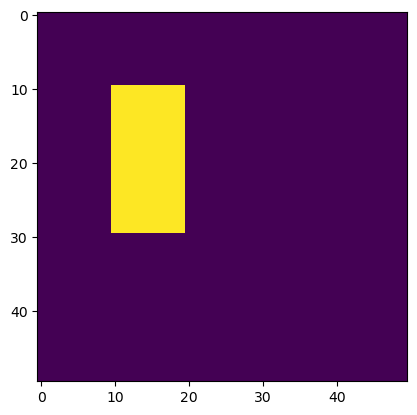

(19.5, 14.5)


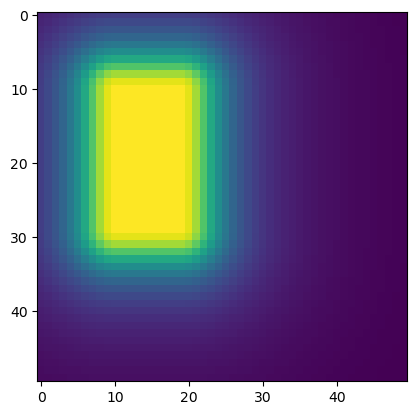

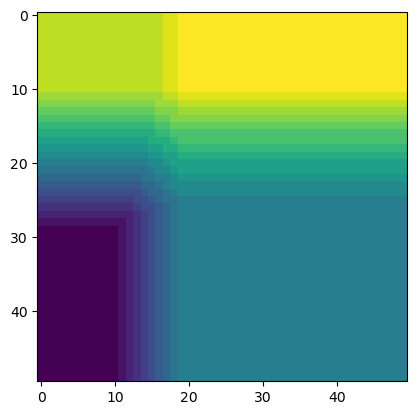

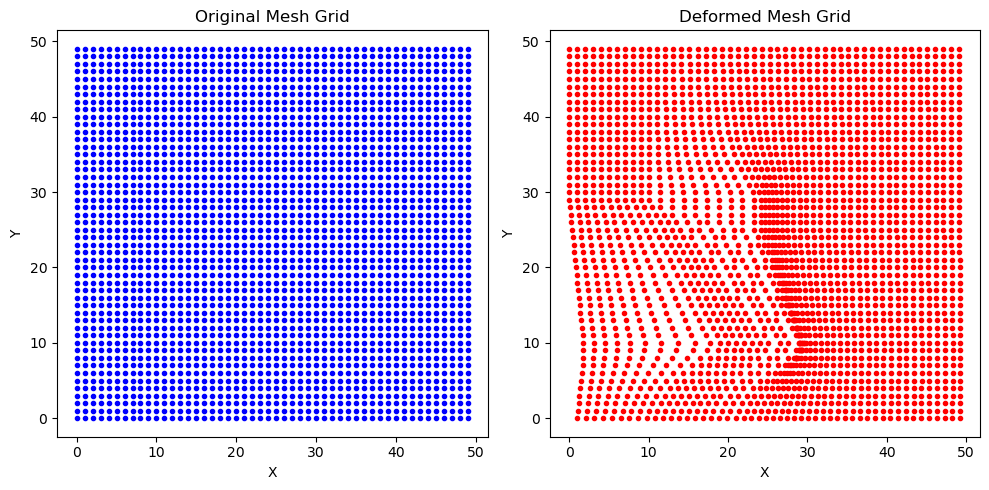

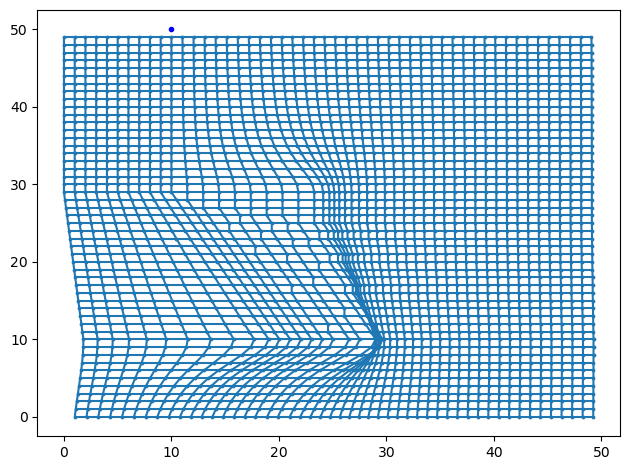

In [21]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
from scipy import ndimage


# Create a mesh grid
x = np.arange(0, 50)  # x-coordinates
y = np.arange(0, 50)  # y-coordinates
X, Y = np.meshgrid(x, y)     # Create mesh grid

mask = np.zeros_like(X)
mask[10:30,10:20] = 1

plt.imshow(mask)
plt.show()

galaxy_cm = np.array([[50, 10]])
elongated_cm = ndimage.center_of_mass(mask)

print(elongated_cm)

alpha = 10
beta = 5
elong_idx = np.argwhere(mask == 1)

min_distance = mask
min_distance = np.linalg.norm(galaxy_cm)
# amplitude = alpha*np.linalg.norm(elong_idx - galaxy_cm, axis=1)/min_distance
# create unit vector that represent the direction
# unit_vec = np.random.rand(2)-0.5
# unit_vec = unit_vec/np.linalg.norm(unit_vec)
unit_vec = np.array([0,1])
unit_vec = unit_vec/np.linalg.norm(unit_vec)


mask, deformed_X, deformed_Y = augmentElongMask(mask, galaxy_cm, X, Y)

map_x = deformed_X.astype(np.float32)
map_y = deformed_Y.astype(np.float32)

# Plot the original and deformed mesh grids
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

axs[0].set_title('Original Mesh Grid')
axs[0].plot(X, Y, '.', color='b')
axs[0].set_xlabel('X')
axs[0].set_ylabel('Y')


axs[1].set_title('Deformed Mesh Grid')
axs[1].plot(deformed_X, deformed_Y, '.', color='r')
axs[1].set_xlabel('X')
axs[1].set_ylabel('Y')

plt.tight_layout()
plt.show()

plt.scatter(map_x, map_y, s=3)
segs1 = np.stack((map_x, map_y), axis=2)
segs2 = segs1.transpose(1,0,2)
plt.gca().add_collection(LineCollection(segs1))
plt.gca().add_collection(LineCollection(segs2))
plt.plot(galaxy_cm[0,1], galaxy_cm[0,0], '.', color='b')
plt.tight_layout()
plt.show()


In [22]:
# def augmentMask(change_mask, unchange_masks, galaxy_cm, mesh_x, mesh_y, alpha=10, eps=0.05):
#     # print(change_mask.shape)
#     mesh_x = mesh_x.astype("float64")
#     mesh_y = mesh_y.astype("float64")

#     binary_mask = change_mask.astype(np.uint8)
#     contours, hierarchy = cv2.findContours(binary_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

#     unit_vec = np.random.rand(2)-0.5
#     # unit_vec = np.array([-1,1])
#     unit_vec = unit_vec/np.linalg.norm(unit_vec)

#     rbf_field = np.zeros_like(change_mask,dtype="float64")
#     stretch_mask_field = np.zeros_like(change_mask)
    
#     galaxy_idx = np.argwhere(change_mask == 1)
#     k = np.linalg.norm(galaxy_idx - galaxy_cm, axis=1)
#     galaxy_cm = galaxy_idx[np.argmin(k)]

#     unchange_mask = np.zeros_like(change_mask)
#     for key in unchange_masks:
#         for i in range(unchange_masks[key].shape[0]):
#             unchange_mask = cv2.bitwise_or(unchange_mask, unchange_masks[key][i,:,:])

#     is_changable = cv2.bitwise_not(unchange_mask).astype("float64")/255.

#     for y in range(binary_mask.shape[1]):
#         for x in range(binary_mask.shape[0]):
#             in_contour = cv2.pointPolygonTest(contours[0], [x,y], measureDist=False)
#             norm = np.linalg.norm(contours[0][:,0,:] - np.array([x,y]), axis=1)
#             min_idx = np.argmin(norm)
#             dist = np.min(norm)

#             # distance to galaxy cm
#             if in_contour < 0:
#                 # if in_contour < 0 then the value is outside of mask 
#                 rbf_field[x,y] = inverseQuadratic(dist, eps=eps)
#                 # if the point is outside of mask then limit value to the maximum
#                 min_idx = np.argmin(norm)
#                 stretch_mask_field[x,y] = np.linalg.norm(contours[0][min_idx,0,:] - galaxy_cm)
#                 # print(stretch_mask_field[x,y])

#             else:
#                 # inside mask
#                 rbf_field[x,y] = 1
#                 stretch_mask_field[x,y] = np.min(np.linalg.norm(np.array([x,y]) - galaxy_cm))
#                 # 

#     stretch_mask_field = stretch_mask_field/np.max(stretch_mask_field)

#     mesh_x += alpha*stretch_mask_field*rbf_field*is_changable*unit_vec[0]
#     mesh_y += alpha*stretch_mask_field*rbf_field*is_changable*unit_vec[1]

#     return mesh_x, mesh_y

In [23]:
def augmentMask(change_mask, unchange_masks, galaxy_cm, mesh_x, mesh_y, alpha=10, eps=0.05):
    # print(change_mask.shape)
    mesh_x = mesh_x.astype("float64")
    mesh_y = mesh_y.astype("float64")

    binary_mask = change_mask.astype(np.uint8)
    contours, hierarchy = cv2.findContours(binary_mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

    # unit_vec = np.array([1,0])
    unit_vec = np.random.rand(2)-0.5
    unit_vec = unit_vec/np.linalg.norm(unit_vec)

    rbf_field = np.zeros_like(change_mask,dtype="float64")
    stretch_mask_field = np.zeros_like(change_mask)
    
    galaxy_idx = np.argwhere(change_mask == 1)
    k = np.linalg.norm(galaxy_idx - galaxy_cm, axis=1)
    galaxy_cm = galaxy_idx[np.argmin(k)][::-1]

    unchange_mask = np.zeros_like(change_mask)
    for key in unchange_masks:
        for i in range(unchange_masks[key].shape[0]):
            unchange_mask = cv2.bitwise_or(unchange_mask, unchange_masks[key][i,:,:])

    is_changable = cv2.bitwise_not(unchange_mask).astype(float) - 254.0
    
    for y in range(binary_mask.shape[0]):
        for x in range(binary_mask.shape[1]):
            in_contour = cv2.pointPolygonTest(contours[0], [x,y], measureDist=False)
            norm = np.linalg.norm(contours[0][:,0,:] - np.array([x,y]), axis=1)
            min_idx = np.argmin(norm)
            dist = np.min(norm)

            # distance to galaxy cm
            if in_contour < 0:
                # if in_contour < 0 then the value is outside of mask 
                rbf_field[y,x] = inverseQuadratic(dist, eps=eps)
                # if the point is outside of mask then limit value to the maximum
                min_idx = np.argmin(norm)
                stretch_mask_field[y,x] = np.linalg.norm(contours[0][min_idx,0,:] - galaxy_cm)
                # print(stretch_mask_field[x,y])

            else:
                # inside mask
                rbf_field[y,x] = 1
                stretch_mask_field[y,x] = np.min(np.linalg.norm(np.array([x,y]) - galaxy_cm))

    stretch_mask_field = stretch_mask_field/np.max(stretch_mask_field)
    
    mesh_x += alpha*rbf_field*stretch_mask_field*is_changable*unit_vec[0]
    mesh_y += alpha*rbf_field*stretch_mask_field*is_changable*unit_vec[1]

    return mesh_x, mesh_y

In [ ]:
def minDistElongs2Objs(elong_masks, obj_masks):
    elong_cms = [ndimage.center_of_mass(mask) for mask in elong_masks]
    obj_cms = [ndimage.center_of_mass(mask) for mask in obj_masks]

    min_dists = []
    min_idxs = []
    for i, elong_cm in enumerate(elong_cms): 
        min_idx = np.argmin(np.linalg.norm(np.array(obj_cms) - elong_cm, axis=1))
        min_dist = np.min(np.linalg.norm(np.array(obj_cms) - elong_cm, axis=1))
        
        min_idxs.append(min_idx)
        min_dists.append(min_dist)

    return min_dists, min_idxs

def elongDeform(_image, _masks=None, amplitude=1, frequency=10):
    height, width = _image.shape[1:]
    # Create a mesh grid
    x = np.linspace(0, width - 1, width)  # x-coordinates
    y = np.linspace(0, height - 1, height)  # y-coordinates
    deformed_X, deformed_Y = np.meshgrid(x, y)  # Create mesh grid

    image = deepcopy(_image)
    masks = deepcopy(_masks)
    
    # # switch from [row, col] to [x,y]
    # for key in masks:
    #     masks[key] = masks[key].transpose(0,2,1)
    
    
    change_masks = masks["Elongated tidal structures"]
    unchange_masks = {}
    for key in ["Galaxy"]:
        if key in masks:
            unchange_masks[key] = masks[key]
    
    i = 0
    if i != None:
    # for i in range(change_masks.shape[0]):
        min_dists, min_idxs = minDistElongs2Objs(change_masks, unchange_masks["Galaxy"])
        galaxy_cm = ndimage.center_of_mass(unchange_masks["Galaxy"][min_idxs[i]])
        deformed_X, deformed_Y = augmentMask(change_masks[i], unchange_masks, galaxy_cm, deformed_X, deformed_Y, alpha=125 eps=0.03)

    map_x = deformed_X.astype(np.float32)
    map_y = deformed_Y.astype(np.float32)
    
    augmented_image = cv2.remap(image.transpose(1,2,0), map_x, map_y, cv2.INTER_LINEAR).transpose(2,0,1)

    if masks is not None:
        augmented_masks = {}
        for key in masks.keys():
            # swap from [channel,x,y] to [row,col,channel]
            # masks[key] = masks[key].transpose(2,1,0)
            masks[key] = masks[key].transpose(1,2,0)
            
            if masks[key].shape[2] == 1:
                masks[key] = masks[key][:,:,0]

            # swap from [row,col,channel] to [channel,row,col]
            augmented_masks[key] = cv2.remap(masks[key], map_x, map_y, cv2.INTER_LINEAR)
            augmented_masks[key] = (augmented_masks[key] >= 0.5).astype(np.uint8)

            if len(masks[key].shape) == 2:
                augmented_masks[key] = augmented_masks[key][np.newaxis,:,:]
            else:
                augmented_masks[key] = augmented_masks[key].transpose(2,0,1)

    if masks is not None:
        return augmented_image, augmented_masks, map_x, map_y
    else:
        return augmented_image


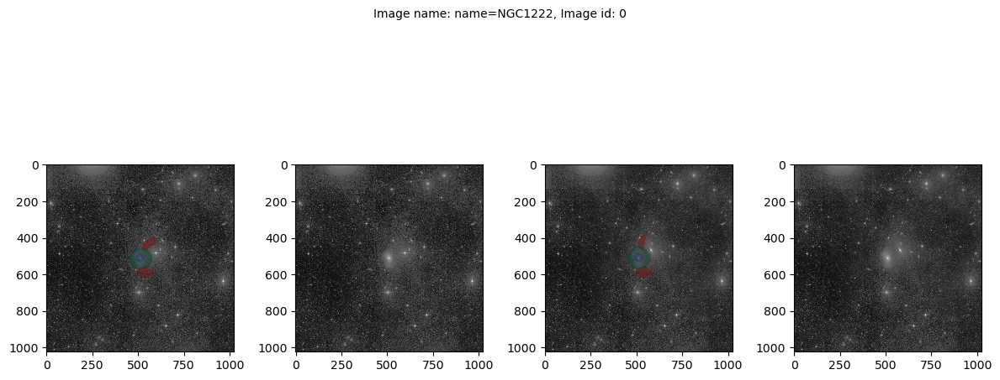

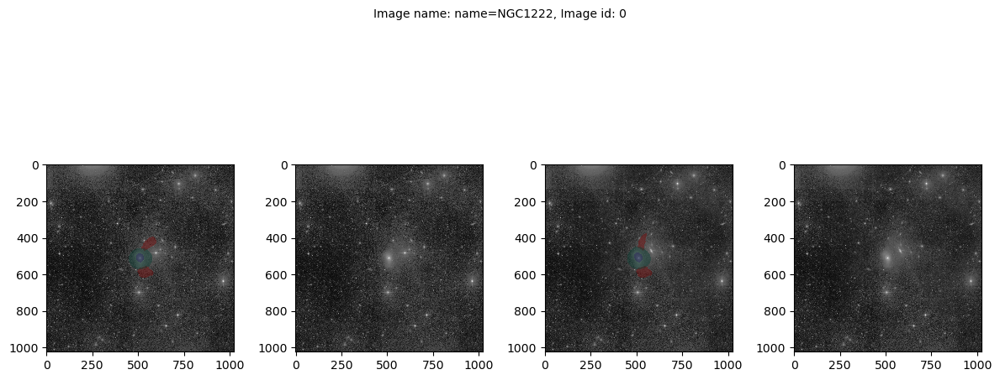

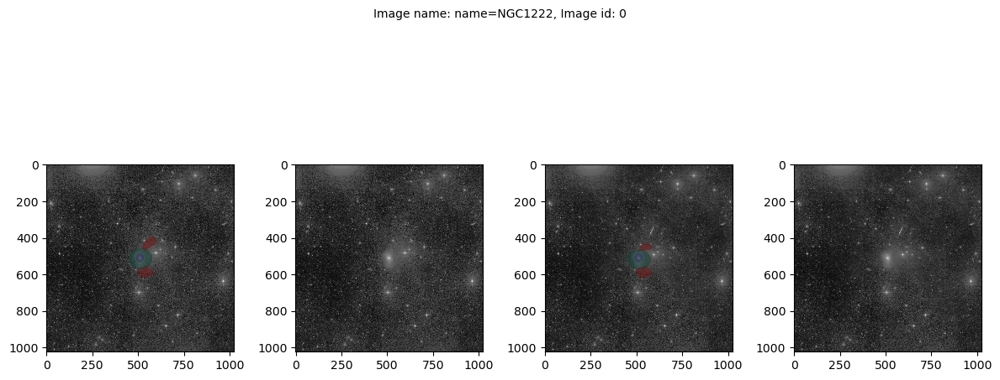

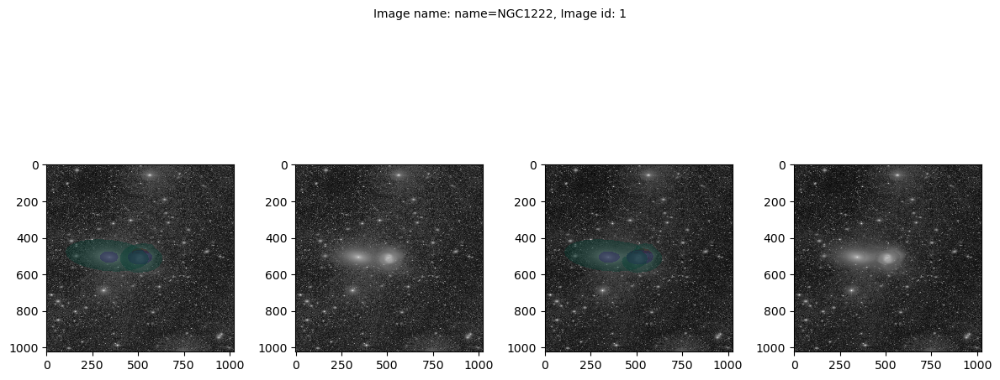

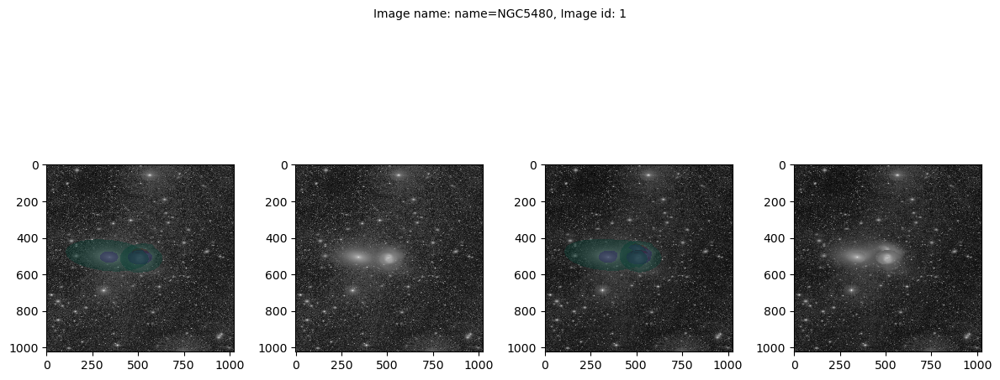

...

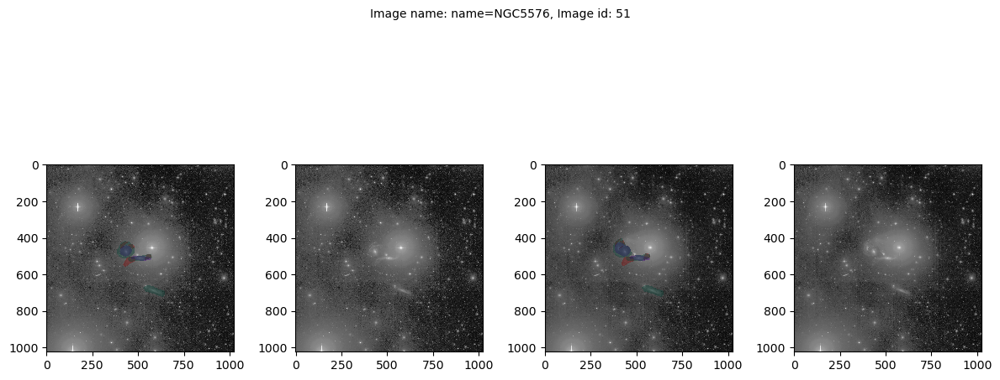

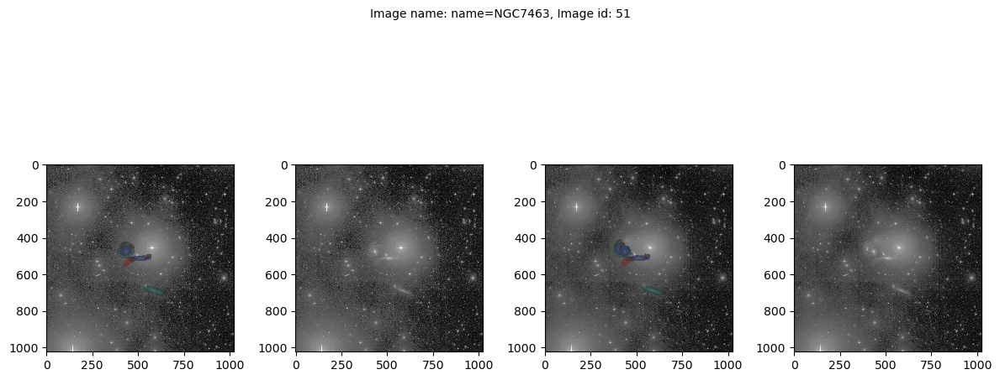

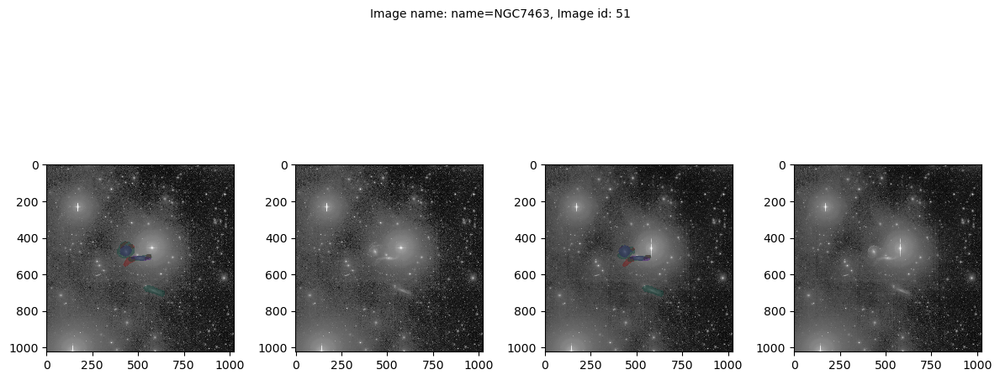

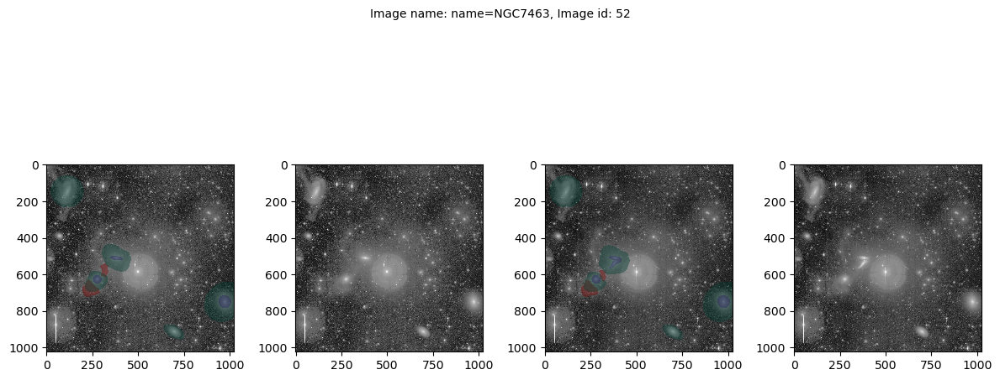

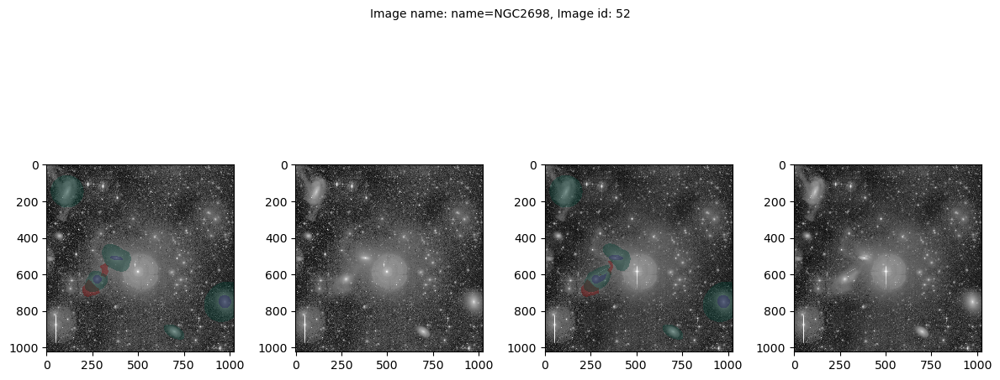

KeyboardInterrupt: 

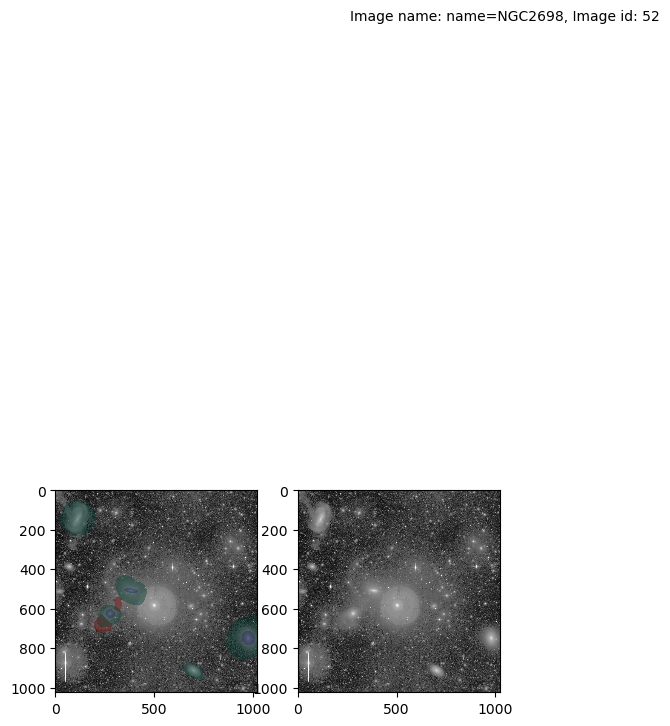

In [47]:
%matplotlib inline
import albumentations as A
import random

COLOR_LIST = ['jet', 'Purples', 'BrBG', 'BuGn', 'GnBu']

SAVE_IMAGE_PATH = "../datasets/matlas_images_and_annotations/images/"
SAVE_ANNOTATION_PATH = "../datasets/matlas_images_and_annotations/annotations/standard/double/basichalosnocompanions_augsplittidal/"

map_x = None
map_y = None
for idx in range(len(mask_files_name["Elongated tidal structures"])):
    data = np.load(file_path + "images/" + structure_files_name[idx])

    masks = {}
    masks["Elongated tidal structures"] = getMask(mask_files_name["Elongated tidal structures"][idx])

    obj_list = ["Galaxy", "Diffuse halo", "Ghosted halo"]

    for obj_type in obj_list:
        try:
            masks[obj_type] = getMask(mask_files_name[obj_type][idx])
        except:
            pass

    # data, masks = elongDeform(data, masks, amplitude=30, frequency = 15)

    for dummy_idx in range(3):
    # dummy_idx = 1
    # if dummy_idx != None:
        fig = plt.figure(figsize=(12,12))
        fig.suptitle('Image name: {}, Image id: {}'.format(dummy_mask_file_name, idx), fontsize=10)

        ax0 = fig.add_subplot(1, 4, 1)
        ax0.imshow(data[0,:,:], "gray" , interpolation='none')
        for j, obj_type in enumerate(["Elongated tidal structures"] + obj_list):
            if obj_type in masks:
                for i in range(masks[obj_type].shape[0]):
                    ax0.imshow(masks[obj_type][i,:,:], COLOR_LIST[j], interpolation='none', alpha=0.4*(masks[obj_type][i,:,:]>0))

        ax1 = fig.add_subplot(1, 4, 2)
        ax1.imshow(data[0,:,:], "gray" , interpolation='none')

        augmented_data, augmented_masks, map_x, map_y = elongDeform(data, masks)
        
        ax2 = fig.add_subplot(1, 4, 3)
        ax2.imshow(augmented_data[0,:,:], "gray" , interpolation='none')
        # plt.imshow(augmented_masks["Elongated tidal structures"][0,:,:], COLOR_LIST[0], interpolation='none', alpha=0.4*(augmented_masks["Elongated tidal structures"][0,:,:]>0))
        for j, obj_type in enumerate(["Elongated tidal structures"] + obj_list):
            if obj_type in augmented_masks:
                for i in range(augmented_masks[obj_type].shape[0]):
                    ax2.imshow(augmented_masks[obj_type][i,:,:], COLOR_LIST[j], interpolation='none', alpha=0.4*(augmented_masks[obj_type][i,:,:]>0))

                [dummy_mask_file_name, dummy_mask_structure] = mask_files_name[obj_type][idx].split('/')[-1].split("-")
                encode_np_mask( augmented_masks[obj_type], SAVE_ANNOTATION_PATH + dummy_mask_file_name + 'D' + str(dummy_idx) + '-' + dummy_mask_structure)
        
        ax3 = fig.add_subplot(1, 4, 4)
        ax3.imshow(augmented_data[0,:,:], "gray" , interpolation='none')


        fig.tight_layout() 
        fig.subplots_adjust(hspace=0.05, bottom=0.5)

        plt.show()

In [ ]:
%matplotlib qt

plt.scatter(map_x, map_y, s=3)
segs1 = np.stack((map_x, map_y), axis=2)
segs2 = segs1.transpose(1,0,2)
plt.gca().add_collection(LineCollection(segs1))
plt.gca().add_collection(LineCollection(segs2))
plt.gca().invert_yaxis()
# plt.plot(galaxy_cm[0,0], galaxy_cm[0,1], '.', color='b')
plt.tight_layout()
plt.show()

In [ ]:
%matplotlib inline
import albumentations as A
import matplotlib.pyplot as plt


# Load an image
image = cv2.imread('sample.jpeg')

augmented_image = elongDeform(image)


# Visualize the original and augmented images
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
axs[0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
axs[0].set_title('Original Image')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(augmented_image, cv2.COLOR_BGR2RGB))
axs[1].set_title('Augmented Image')
axs[1].axis('off')

plt.tight_layout()
plt.show()